<a href="https://colab.research.google.com/github/ksairos/tf-advanced-techniques-course/blob/main/course_4/C4_W4_Labs_GANs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Simple GAN

## Imports

In [ ]:
import tensorflow as tf
import tensorflow.keras as keras

import numpy as np
import matplotlib.pyplot as plt
from IPython import display
import PIL
import imageio
import glob
import os

In [ ]:
!pip install git+https://github.com/tensorflow/docs

import tensorflow_docs.vis.embed as embed

In [ ]:
!mkdir FashionMNIST

## Utilities

In [ ]:
def plot_multiple_images(model, input, n_cols=16, save=False, epoch=0, prefix=None):

    '''visualizes fake images'''

    display.clear_output(wait=False)  
    images = model(input, training=False)

    n_cols = n_cols or len(images)
    n_rows = (len(images) - 1) // n_cols + 1

    if images.shape[-1] == 1:
        images = np.squeeze(images, axis=-1)

    plt.figure(figsize=(n_cols, n_rows))
    
    for index, image in enumerate(images):
        plt.subplot(n_rows, n_cols, index + 1)
        plt.imshow(image, cmap="binary")
        plt.axis("off")

    if save:
      try:
        os.mkdir(prefix)
      except:
        pass
        
      plt.savefig('{}/image_at_epoch_{:04d}.png'.format(prefix, epoch))

    plt.show()

In [ ]:
def generate_and_save_images(model, epoch, test_input):
  # Notice `training` is set to False.
  # This is so all layers run in inference mode (batchnorm).
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
      plt.subplot(4, 4, i+1)
      plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
      plt.axis('off')

  plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

## Download and prepare the dataset

In [ ]:
# load the train set of the MNIST dataset
(X_train, _), _ = keras.datasets.mnist.load_data()

# normalize pixel values
X_train = X_train.astype(np.float32) / 255

In [ ]:
BATCH_SIZE = 128

dataset = tf.data.Dataset.from_tensor_slices(X_train).shuffle(1000)
dataset = dataset.batch(BATCH_SIZE, drop_remainder=True).prefetch(1)

## Build my first GAN model

### Generator

In [ ]:
# declare shape of the noise input
random_normal_dimensions = 32

# build the generator model
generator = keras.models.Sequential([                                 
    keras.layers.Dense(64, activation="selu", input_shape=[random_normal_dimensions]),
    keras.layers.Dense(128, activation="selu"),
    keras.layers.Dense(28 * 28, activation="sigmoid"),
    keras.layers.Reshape([28, 28])
])

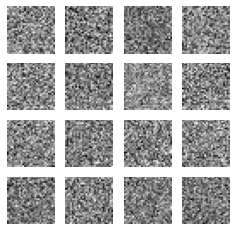

In [ ]:
# generate a batch of noise input (batch size = 16)
test_noise = tf.random.normal([16, random_normal_dimensions])

# visualize sample output
plot_multiple_images(generator, test_noise, n_cols=4)

### Discriminator

In [ ]:
# build the discriminator model
discriminator = keras.models.Sequential([
    keras.layers.Flatten(input_shape=[28, 28]),
    keras.layers.Dense(128, activation="selu"),
    keras.layers.Dense(64, activation="selu"),
    keras.layers.Dense(1, activation="sigmoid")
])

In [ ]:
# Build the whole GAN model
gan = keras.models.Sequential([generator, discriminator])

### Compile the model

In [ ]:
discriminator.compile(loss="binary_crossentropy", optimizer="rmsprop")
discriminator.trainable = False
gan.compile(loss="binary_crossentropy", optimizer="rmsprop")

## Train the model

In [ ]:
def train_gan(gan, dataset, random_normal_dimensions, n_epochs=50):
    """ Defines the two-phase training loop of the GAN
    Args:
      gan -- the GAN model which has the generator and discriminator
      dataset -- the training set of real images
      random_normal_dimensions -- dimensionality of the input to the generator
      n_epochs -- number of epochs
    """

    # define visualization noise for
    viz_noise = tf.random.normal(shape=[BATCH_SIZE, random_normal_dimensions])

    # get the two sub networks from the GAN model
    generator, discriminator = gan.layers

    # start loop
    for epoch in range(n_epochs):
        print("Epoch {}/{}".format(epoch + 1, n_epochs))       
        for real_images in dataset:

            # Train the discriminator - PHASE 1
            # Create the noise
            noise = tf.random.normal(shape=[BATCH_SIZE, random_normal_dimensions])
            
            # Use the noise to generate fake images
            fake_images = generator(noise)
            
            # Create a list by concatenating the fake images with the real ones
            mixed_images = tf.concat([fake_images, real_images], axis=0)
            
            # Create the labels for the discriminator
            # 0 for the fake images
            # 1 for the real images
            discriminator_labels = tf.constant([[0.]] * BATCH_SIZE + [[1.]] * BATCH_SIZE)
            
            # Ensure that the discriminator is trainable
            discriminator.trainable = True
            
            # Use train_on_batch to train the discriminator with the mixed images and the discriminator labels
            discriminator.train_on_batch(mixed_images, discriminator_labels)
            
            # Train the generator - PHASE 2
            # create a batch of noise input to feed to the GAN
            noise = tf.random.normal(shape=[BATCH_SIZE, random_normal_dimensions])

            # label all generated images to be "real"
            generator_labels = tf.constant([[1.]] * BATCH_SIZE)

            # Freeze the discriminator
            discriminator.trainable = False

            # Train the GAN on the noise with the labels all set to be true
            gan.train_on_batch(noise, generator_labels)

        # plot the fake images used to train the discriminator
        plot_multiple_images(generator, viz_noise, 16, save=True, epoch=epoch, prefix="MNIST")

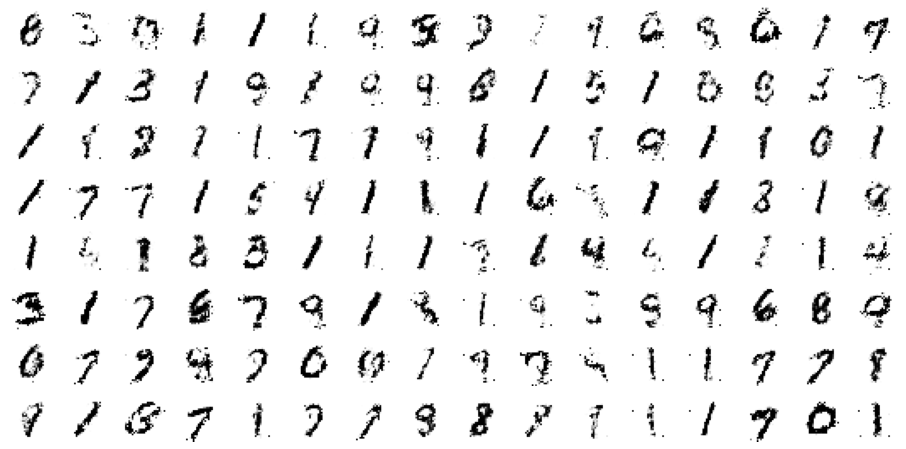

In [ ]:
train_gan(gan, dataset, random_normal_dimensions, n_epochs=20)

In [ ]:
anim_file = 'mnist_gan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('MNIST/image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)


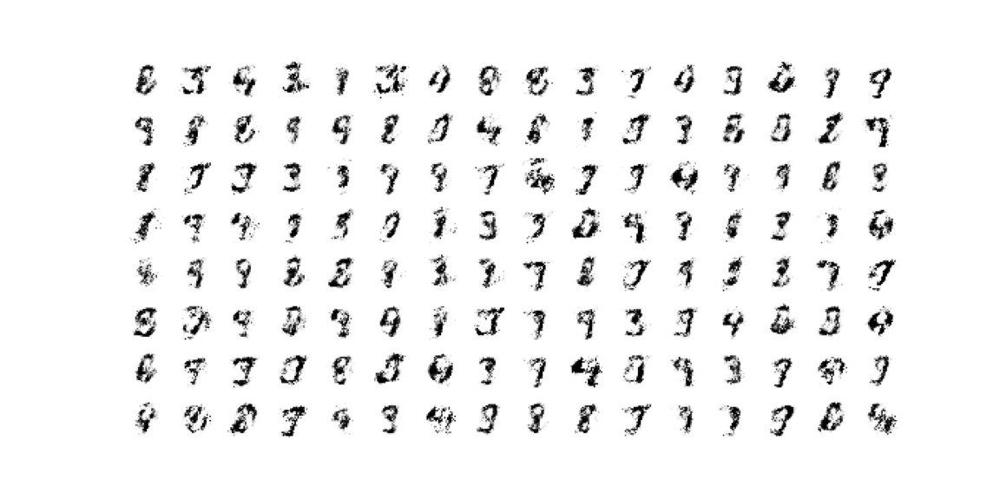

In [47]:
embed.embed_file(anim_file)

Resulting data shows that our model is skewed to generating 1s and 7s as they are more likely to be misinterpreted by the Discriminator. For better performance we will use Deep Convolutional GANs

# Deep Convolutional GAN

## Download and prepare Fashion MNIST dataset

In [ ]:
# download the training images
(X_train, _), _ = keras.datasets.fashion_mnist.load_data()

# normalize pixel values
X_train = X_train.astype(np.float32) / 255

# reshape and rescale
X_train = X_train.reshape(-1, 28, 28, 1) * 2. - 1.

BATCH_SIZE = 128

# create batches of tensors to be fed into the model
dataset = tf.data.Dataset.from_tensor_slices(X_train)
dataset = dataset.shuffle(1000)
dataset = dataset.batch(BATCH_SIZE, drop_remainder=True).prefetch(1)

## Build the Model

In [ ]:
keras.backend.clear_session()

### Generator

In [ ]:
from keras.layers import Dense, Reshape, Conv2DTranspose, Conv2D, BatchNormalization, Dropout, Flatten, LeakyReLU
from keras.models import Sequential

codings_size = 32

generator = Sequential([
    Dense( 7 * 7 * 128, input_shape=[codings_size]),
    Reshape( [7, 7, 128] ),
    BatchNormalization(),
    Conv2DTranspose( 64, kernel_size=5, strides=2, padding='same', activation='selu'),
    BatchNormalization(),
    Conv2DTranspose( 1, kernel_size=5, strides=2, padding='same', activation='tanh'),
])

In [ ]:
generator.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 6272)              206976    
                                                                 
 reshape (Reshape)           (None, 7, 7, 128)         0         
                                                                 
 batch_normalization (BatchN  (None, 7, 7, 128)        512       
 ormalization)                                                   
                                                                 
 conv2d_transpose (Conv2DTra  (None, 14, 14, 64)       204864    
 nspose)                                                         
                                                                 
 batch_normalization_1 (Batc  (None, 14, 14, 64)       256       
 hNormalization)                                                 
                                                        

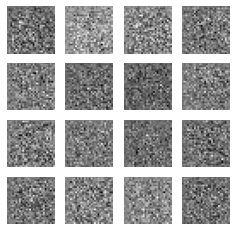

shape of the generated batch: (16, 28, 28, 1)


In [ ]:
# generate a batch of noise input (batch size = 16)
test_noise = tf.random.normal([16, codings_size])

# visualize sample output
plot_multiple_images(generator, test_noise, n_cols=4)

print(f'shape of the generated batch: {test_image.shape}')

### Discriminator

In [ ]:
discriminator = Sequential([
    Conv2D(64, kernel_size=5, strides=2, padding='same', input_shape=[28, 28, 1]),
    LeakyReLU(0.2),
    Dropout(0.4),

    Conv2D(128, kernel_size=5, strides=2, padding='same'),
    LeakyReLU(0.2),
    Dropout(0.4),

    Flatten(),
    Dense(1, activation='sigmoid')
])

discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 14, 14, 64)        1664      
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 14, 14, 64)        0         
                                                                 
 dropout (Dropout)           (None, 14, 14, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 7, 7, 128)         204928    
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 7, 7, 128)         0         
                                                                 
 dropout_1 (Dropout)         (None, 7, 7, 128)         0         
                                                                 
 flatten (Flatten)           (None, 6272)             

In [ ]:
# Build GAN model
gan = keras.models.Sequential([generator, discriminator])

## Configure the model for training

In [ ]:
discriminator.compile(loss='binary_crossentropy', optimizer='rmsprop')
discriminator.trainable = False

gan.compile(loss='binary_crossentropy', optimizer='rmsprop')

## Train the model

In [ ]:
def train_gan(gan, dataset, random_normal_dimensions, n_epochs=50):
  """ Defines the two-phase training loop of the GAN
  Args:
    gan -- the GAN model which has the generator and discriminator
    dataset -- the training set of real images
    random_normal_dimensions -- dimensionality of the input to the generator
    n_epochs -- number of epochs
  """

  viz_noise = tf.random.normal(shape=[BATCH_SIZE, random_normal_dimensions])

  generator, discriminator = gan.layers
  for epoch in range(n_epochs):
    print("Epoch {}/{}".format(epoch + 1, n_epochs))  
    
    for real_images in dataset:

      # PHASE 1 - train discriminator

      # create the random noise
      noise = tf.random.normal(shape=[BATCH_SIZE, random_normal_dimensions])
      
      # use the noise to generate fake images
      fake_images = generator(noise)

      # concatenate fake images with the real ones
      mixed_images = tf.concat([fake_images, real_images], axis=0)

      # create labels for the discriminator
      # 1s for real and 0s for fake
      discriminator_labels = tf.constant([[0.]] * BATCH_SIZE + [[1.]] * BATCH_SIZE)

      # ensure the discriminator is trainable
      discriminator.trainable = True

      # use train_on_batch to train the discriminator with the mixed images and the discriminator labels
      discriminator.train_on_batch(mixed_images, discriminator_labels)

      # PHASE 2 - train generator

      # create the noise to feed to the GAN
      noise = tf.random.normal(shape=[BATCH_SIZE, random_normal_dimensions])

      # label all generated images to "real"
      generator_labels = tf.constant([[1.]] * BATCH_SIZE)

      # freeze discriminator layers to prevent learning wrong labels
      discriminator.trainable = False

      # train the GAN on the noise with the labels all set to be true
      gan.train_on_batch(noise, generator_labels)

    # plot the fake images used to train the discriminator
    plot_multiple_images(generator, viz_noise, 16, save=True, epoch=epoch, prefix="FashionMNIST")

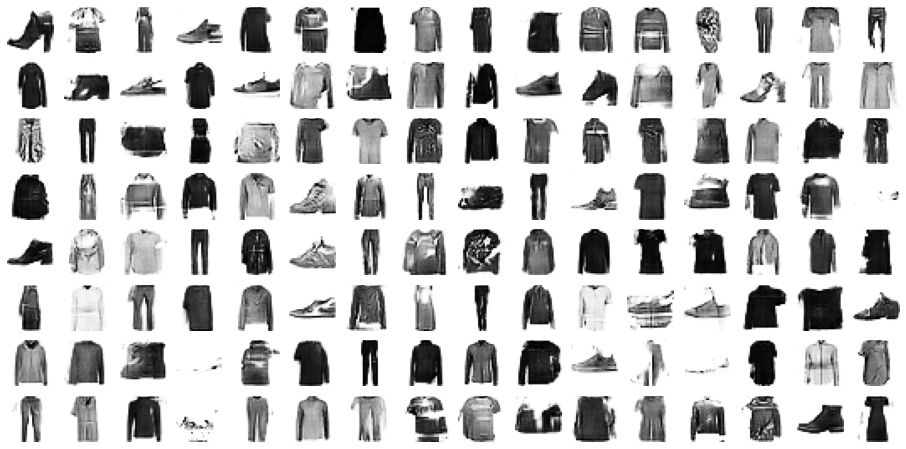

In [ ]:
train_gan(gan, dataset, codings_size, 50)

## Create GIF on generated images

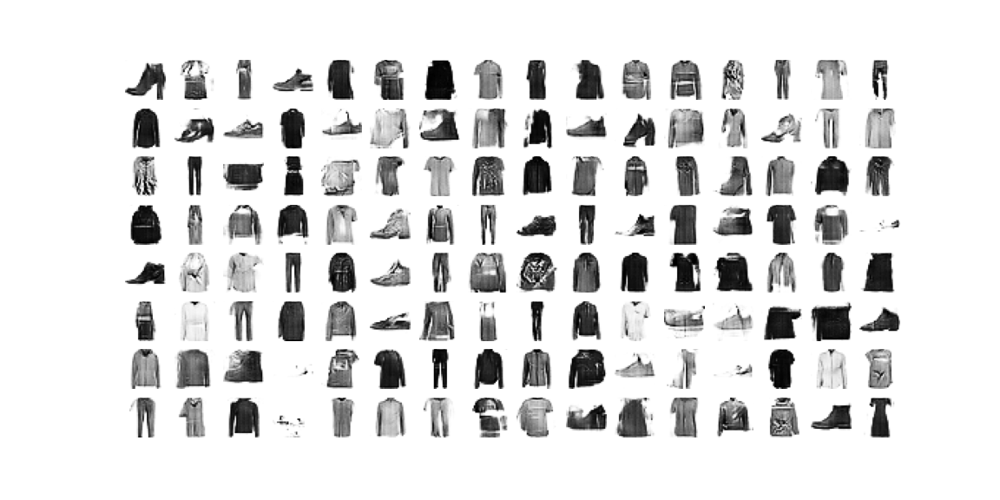

In [ ]:
# Display a single image using the epoch number
def display_image(prefix, epoch_no):
  return PIL.Image.open('{}/image_at_epoch_{:04d}.png'.format(prefix, epoch_no))

display_image("FashionMNIST", 40)

In [ ]:
anim_file = 'Fmnist_dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('FashionMNIST/image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)


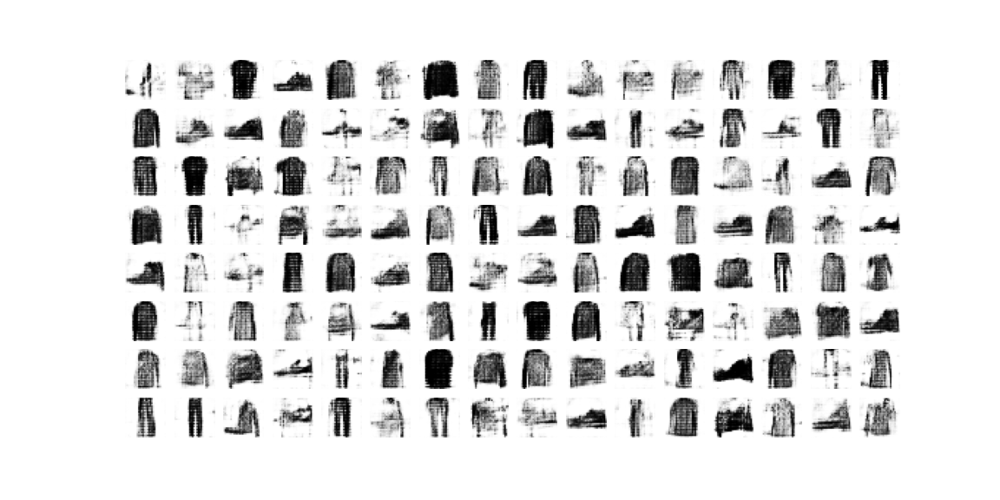

In [ ]:
embed.embed_file(anim_file)